# DAS Data Compression using Autoencoder

This notebook shows how to do lossy DAS data compression using neural networks (Autoencoder). The original code is from [TensorFlow Compression](https://github.com/tensorflow/compression).

## Paper and posts for understanding related theories

1. [End-to-end Optimized Image Compression](https://arxiv.org/abs/1611.01704)
2. [Image Compression Using Autoencoders in Keras](https://blog.paperspace.com/autoencoder-image-compression-keras/)
3. [AI-Based Image Compression: The State of the Art](https://towardsdatascience.com/ai-based-image-compression-the-state-of-the-art-fb5aa6042bfa)

Import library dependencies.

In [1]:
import glob
import random
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

import sys
sys.path.append('../models/')
from model import train_das_model, make_das_codec
from utils import extract_image_patches_fast, extract_image_patches, prepare_das_dataset, reconstruct_image_from_patches, load_patch_from_file
from utils import norm_channel

plt.rcParams.update({'font.size': 12})
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

2023-06-04 20:04:43.518940: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-04 20:04:46.234033: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Load the preprocessed DAS data

In [2]:
# Set the data for trainning
file_train = sorted(glob.glob('../data/train/*.npz'))
file_test = sorted(glob.glob('../data/test/*.npz'))

../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T10-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T19-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-03_T00-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T10-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T19-10-55_p03min.npz     Data shape:  (4800, 900)
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.

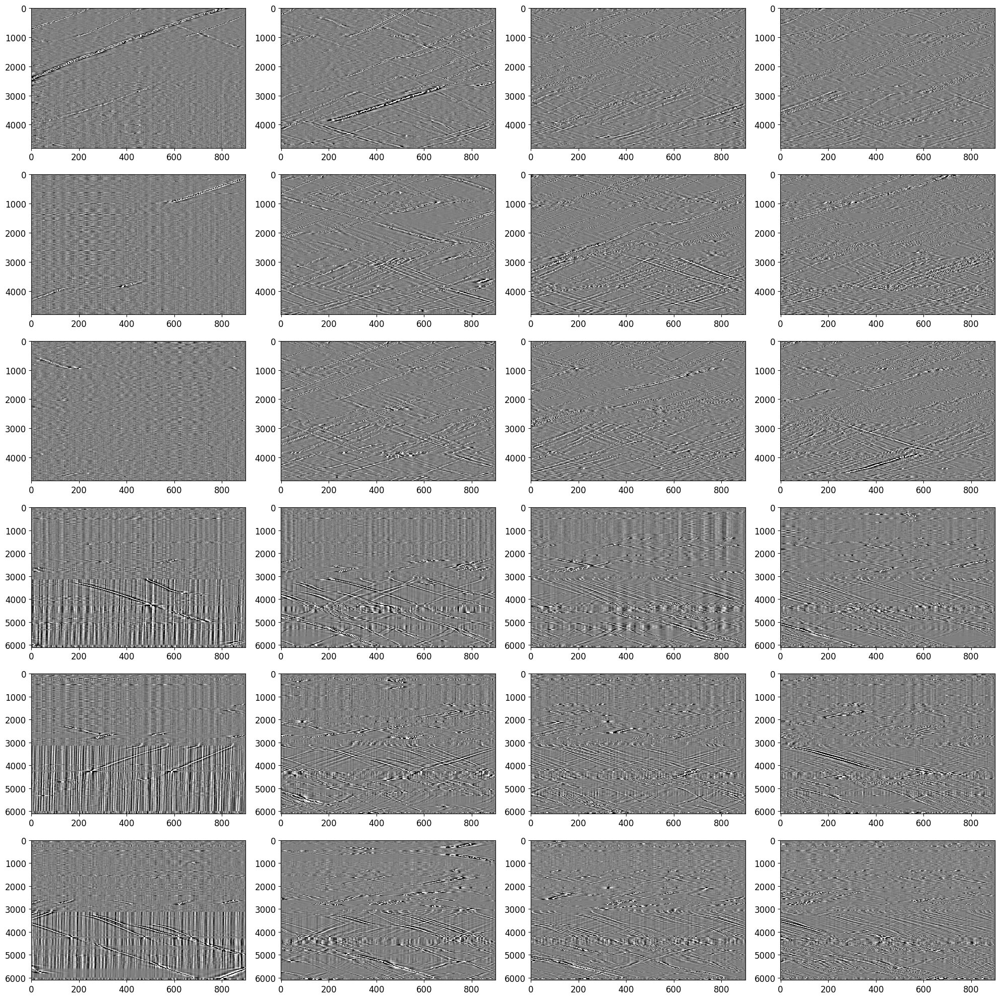

In [3]:
# Plot all trainning DAS data
plt.figure(figsize=(20, 20))
for i, file in enumerate(file_test):
    # Load the data and print basic retrieved parameters
    pdata = norm_channel(np.load(file)['pdata'])

    print(file, '    Data shape: ', pdata.shape)

    # Plot 
    plt.subplot(6, 4, i+1)
    pclip = np.percentile(pdata, 97.)
    plt.imshow(pdata, cmap='gray', aspect='auto', vmin=-pclip, vmax=pclip)

plt.tight_layout()
plt.show()

In [8]:
# Setup parameters for generating patches
patch_size = 32          # size of each patch
train_ratio = 0.8        # ratio between training and dev 
shuffle = True           # shuffle all patches or not
overlap = False          # overlap or not when retriving patches, i.e., tile for half patch_size
add_noise = True         # add random noise to each patch or not
snr = 150                # value for signal-to-noise ratio

# Setup parameters for training model
lmbda = 2000         # weight for rate–distortion Lagrangian
latent_dims = 100    # layers in latent space
epochs = 100          # epoch
batch_size = 128     # batch size
learning_rate = 1e-3 # learning rate
validation_freq = 1  # validation frequency

### Learning Rate

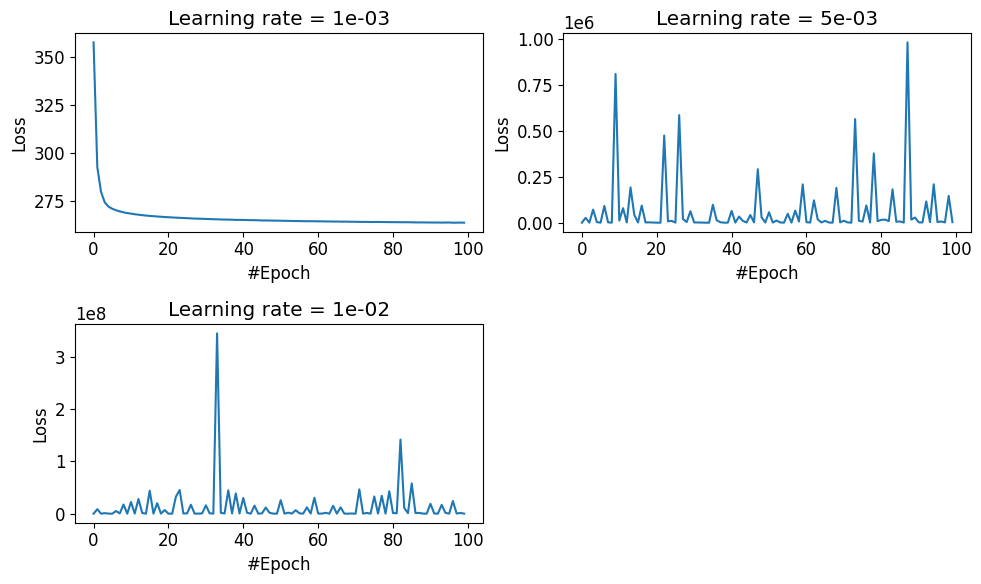

In [9]:
patch_size = 32

plt.figure(figsize=(10,6))
for i, learning_rate in enumerate([1e-3, 5e-3, 1e-2]):
    path = f"../results/model_patch{patch_size}_lmbda{lmbda}_latent{latent_dims}_learning_rate{learning_rate}_epochs{epochs}_noise{add_noise}" 
    plt.subplot(2, 2, i + 1)
    plt.plot(np.loadtxt(os.path.join(path, 'loss')))
    plt.xlabel('#Epoch')
    plt.ylabel('Loss')
    plt.title('Learning rate = %.0e'%learning_rate)

plt.tight_layout()
plt.savefig('../results/loss_learning_rate.png', dpi=300, pad_inches=0.1)
plt.show()

### Patch Size

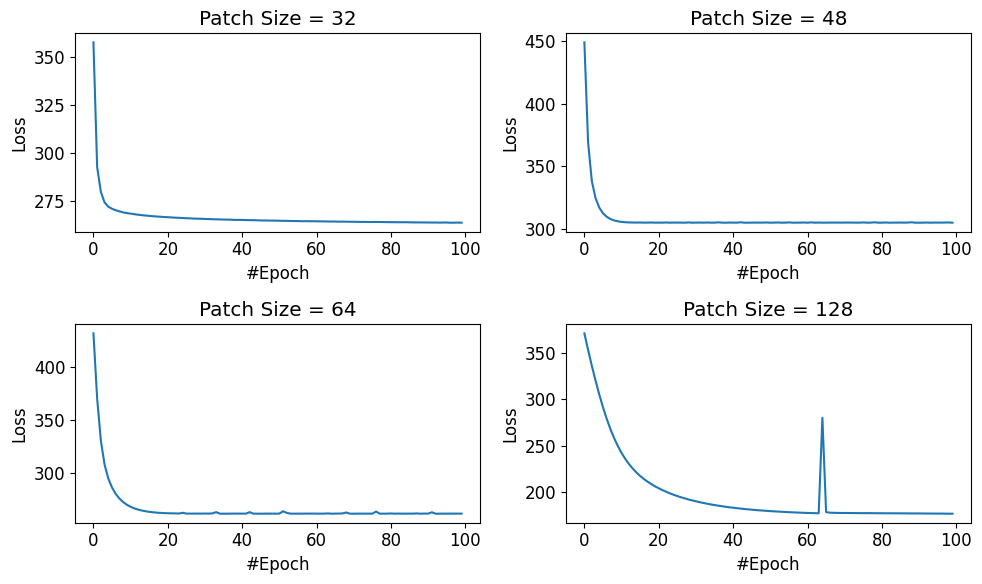

In [10]:
loss_list = 'loss'
learning_rate = 1e-3
plt.figure(figsize=(10,6))
for i, patch_size in enumerate([32, 48, 64, 128]):  
    path = f"../results/model_patch{patch_size}_lmbda{lmbda}_latent{latent_dims}_learning_rate{learning_rate}_epochs{epochs}_noise{add_noise}" 
    plt.subplot(2, 2, i + 1)
    plt.plot(np.loadtxt(os.path.join(path, 'loss')))
    plt.xlabel('#Epoch')
    plt.ylabel('Loss')
    plt.title('Patch Size = %d'%patch_size)

plt.tight_layout()
plt.savefig('../results/loss_patch_size.png', dpi=300, pad_inches=0.1)
plt.show()

In [11]:
# Setup parameters for generating patches
patch_size = 32          # size of each patch
train_ratio = 0.8        # ratio between training and dev 
shuffle = True           # shuffle all patches or not
overlap = False          # overlap or not when retriving patches, i.e., tile for half patch_size
add_noise = True         # add random noise to each patch or not
snr = 150                # value for signal-to-noise ratio

# Setup parameters for training model
lmbda = 2000         # weight for rate–distortion Lagrangian
latent_dims = 100    # layers in latent space
epochs = 50          # epoch
batch_size = 128     # batch size
learning_rate = 1e-3 # learning rate
validation_freq = 1  # validation frequency

## latent_dims: layers in latent space

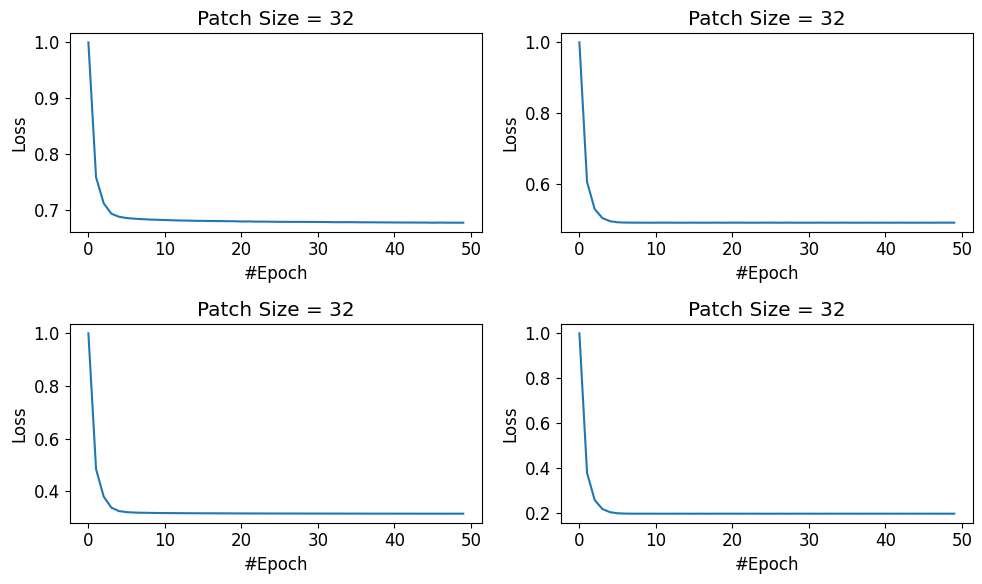

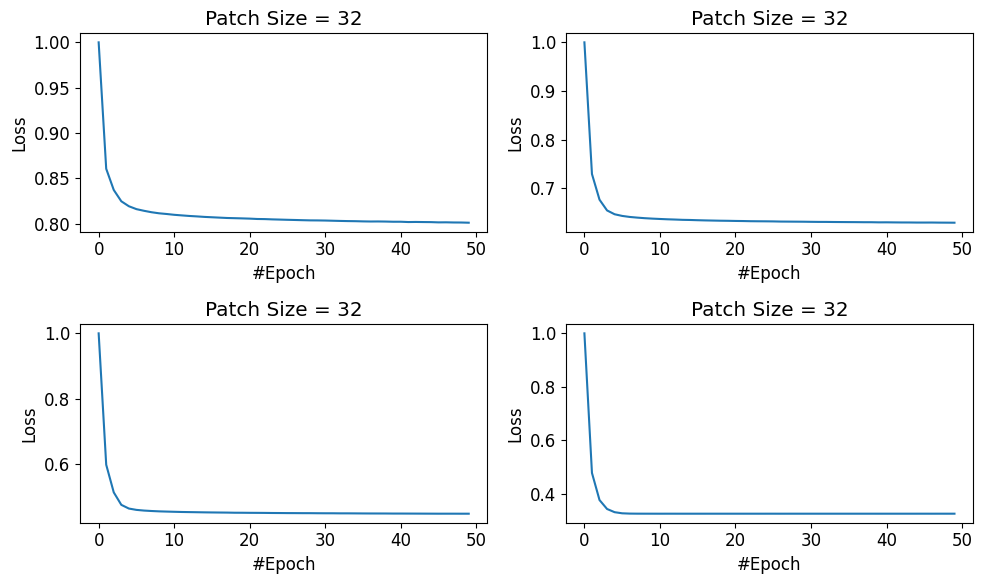

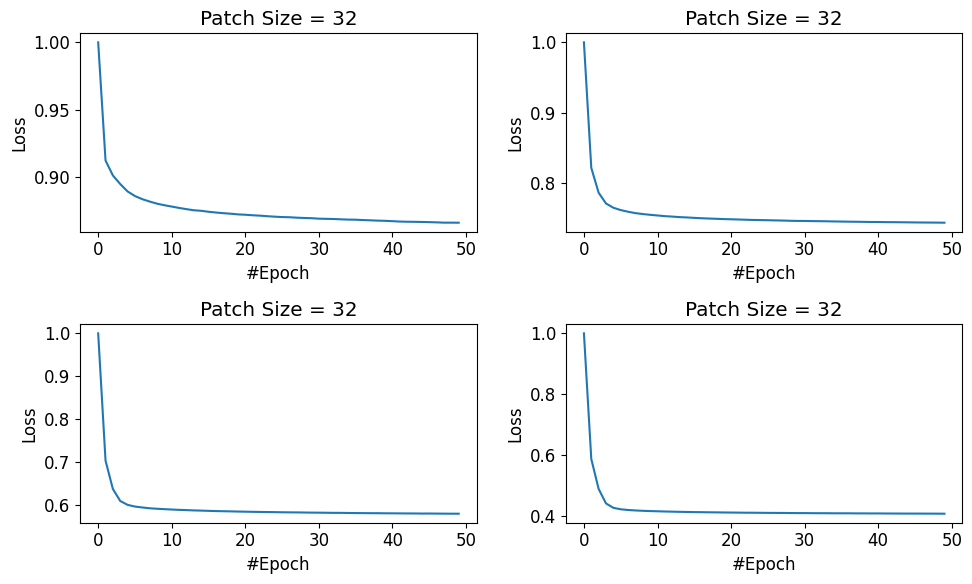

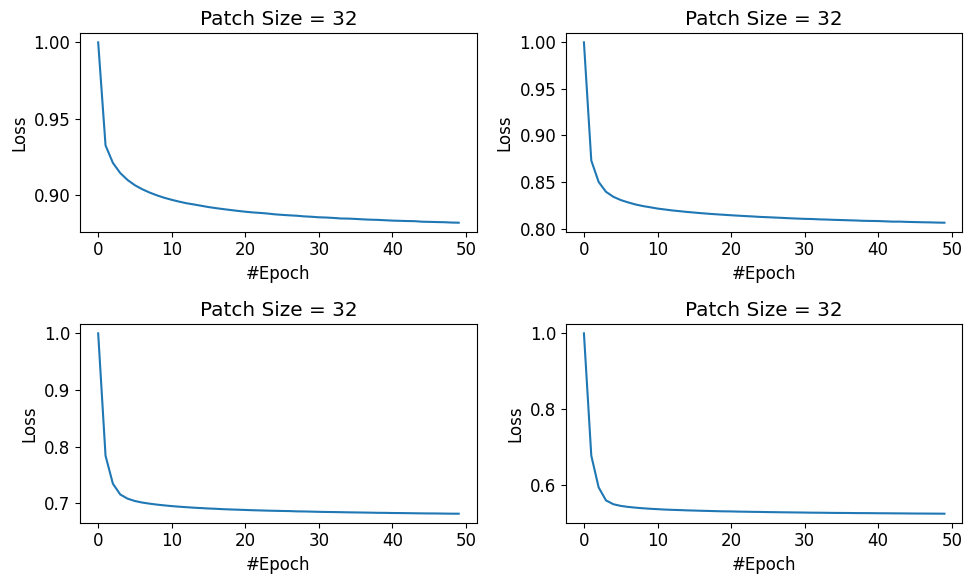

In [12]:
loss_list = 'loss'
learning_rate = 1e-3
lmbda = 500      # [500, 1000, 2000, 4000]

for lmbda in [500, 1000, 2000, 4000]:   
    plt.figure(figsize=(10,6))
    for i, latent_dims in enumerate([50, 100, 200, 400]):      
        path = f"../results/model_patch{patch_size}_lmbda{lmbda}_latent{latent_dims}_learning_rate{learning_rate}_epochs{epochs}_noise{add_noise}" 
        plt.subplot(2, 2, i + 1)
        loss = np.loadtxt(os.path.join(path, 'loss'))
        plt.plot(loss / np.max(loss))
        plt.xlabel('#Epoch')
        plt.ylabel('Loss')
        plt.title('Patch Size = %d'%patch_size)

    plt.tight_layout()
    plt.savefig(f'../results/loss_lambda{lmbda}_latent_dims{latent_dims}.png', dpi=300, pad_inches=0.1)
    plt.show()

## Test

2023-06-04 20:06:16.642943: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 14587 MB memory:  -> device: 0, name: Tesla V100-PCIE-16GB, pci bus id: 0000:3b:00.0, compute capability: 7.0


../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz


2023-06-04 20:06:28.260804: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:424] Loaded cuDNN version 8600


../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.

../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz


/tmp/ipykernel_17719/912335823.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 9))


../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz


../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.

../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-04_T14-10-55_p03min.npz
../data/test/test_smcity_sandhill_nc6100_ch0-6100_nt900_sf5_bp0.08-2.0_D2022-10-06_T14-10-55_p03min.npz


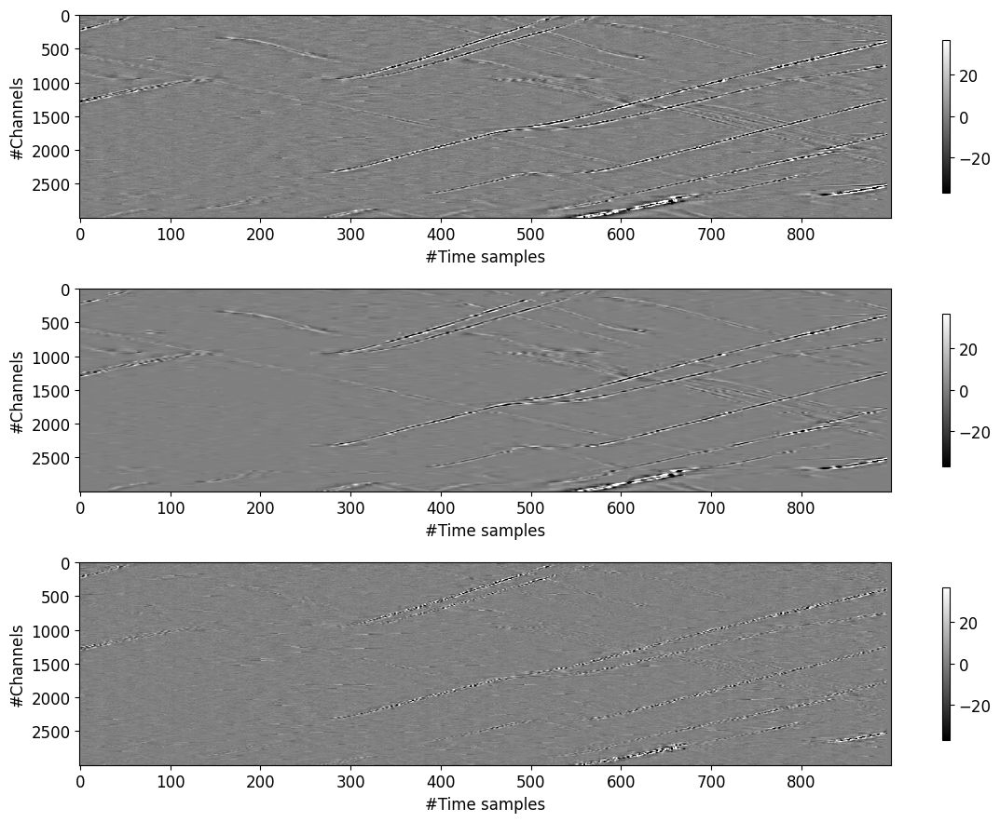

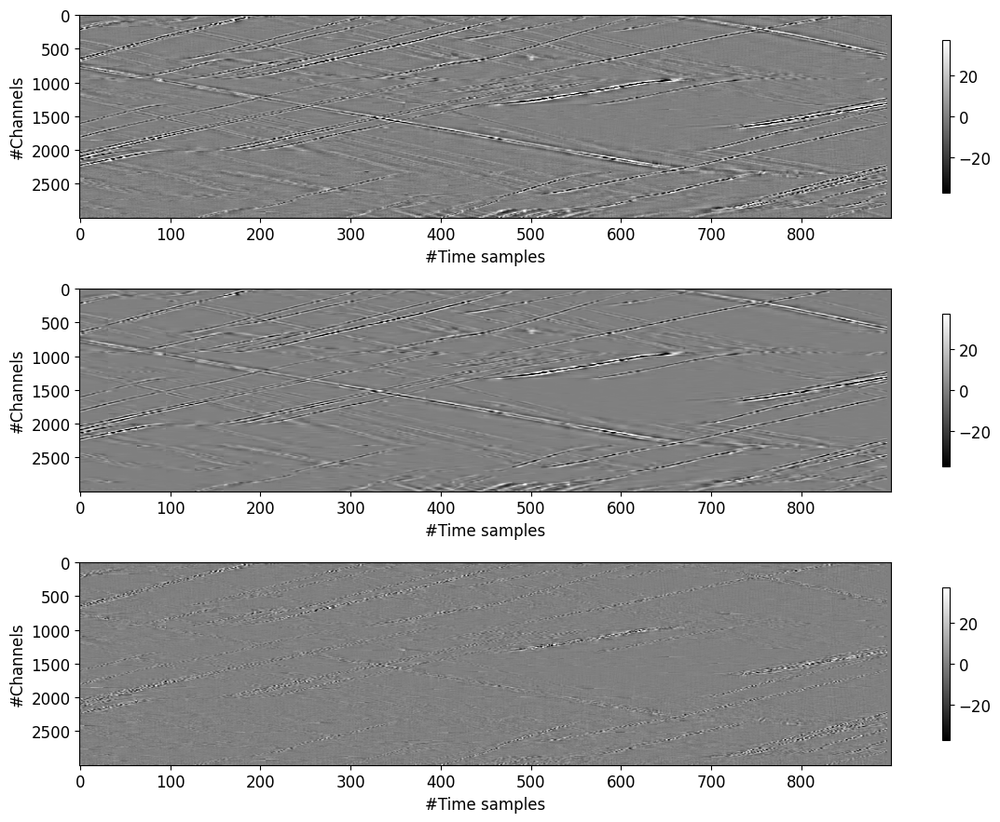

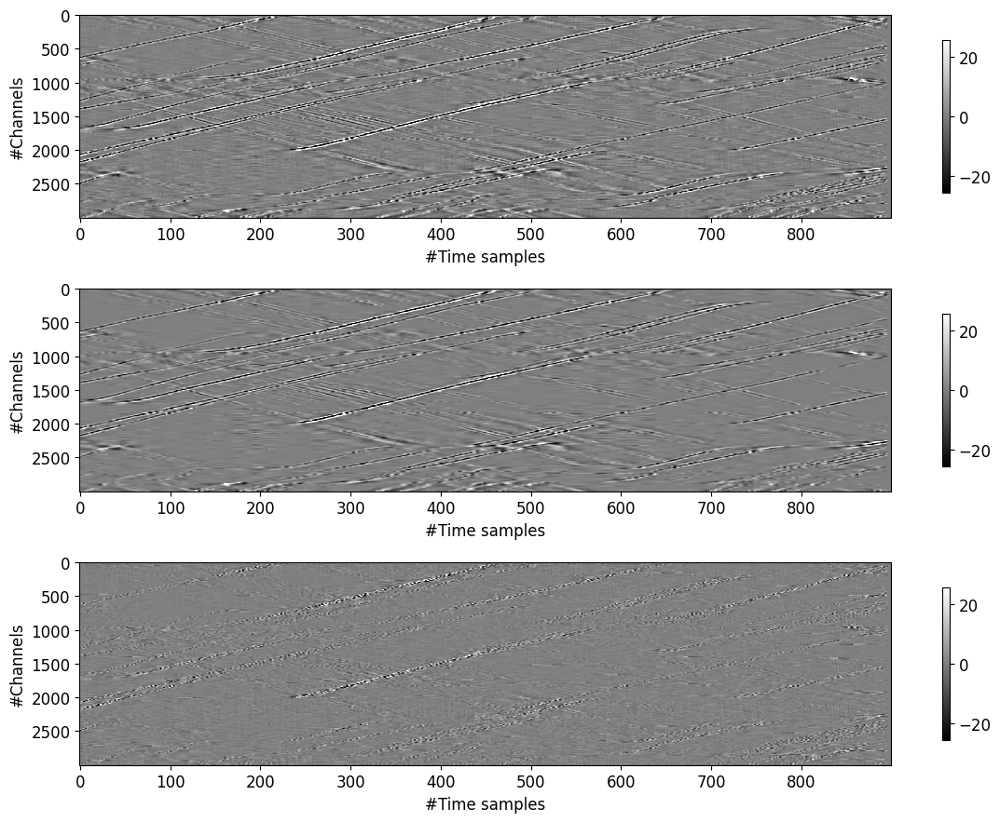

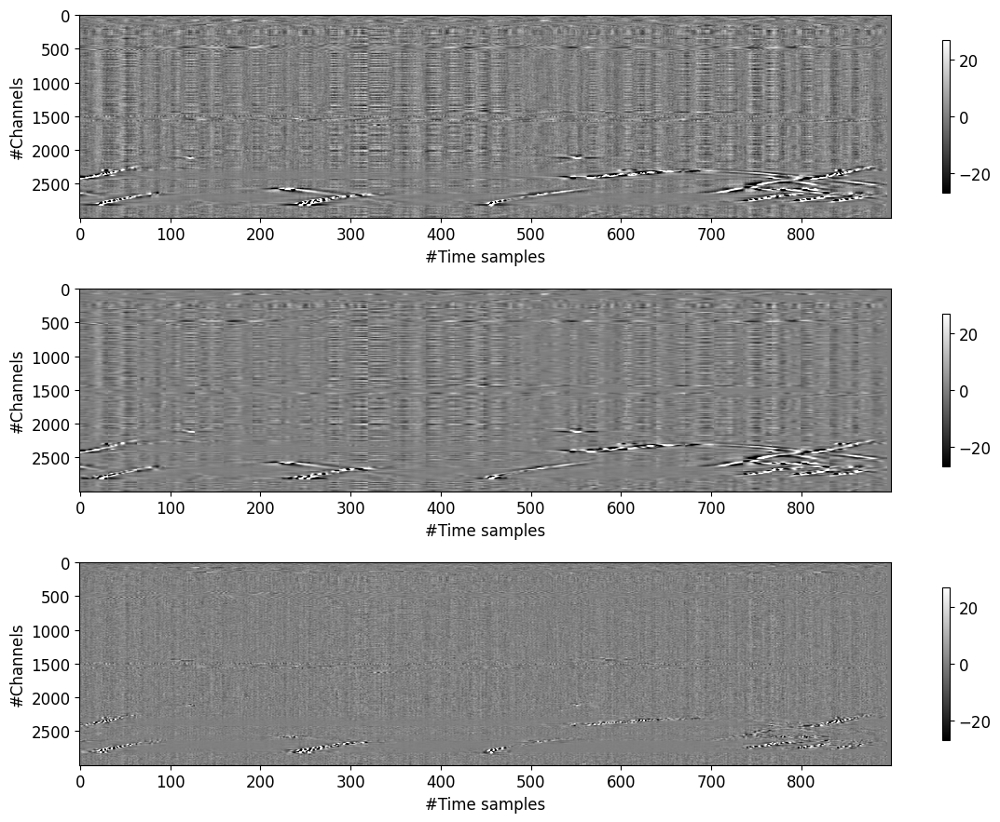

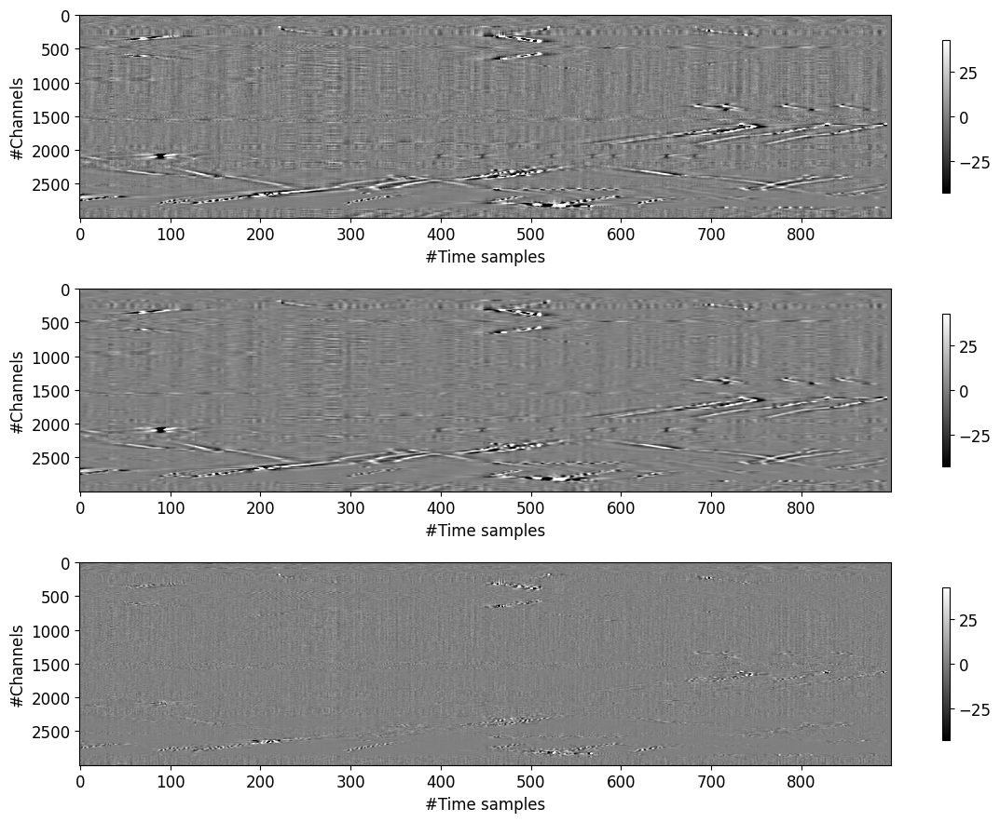

...

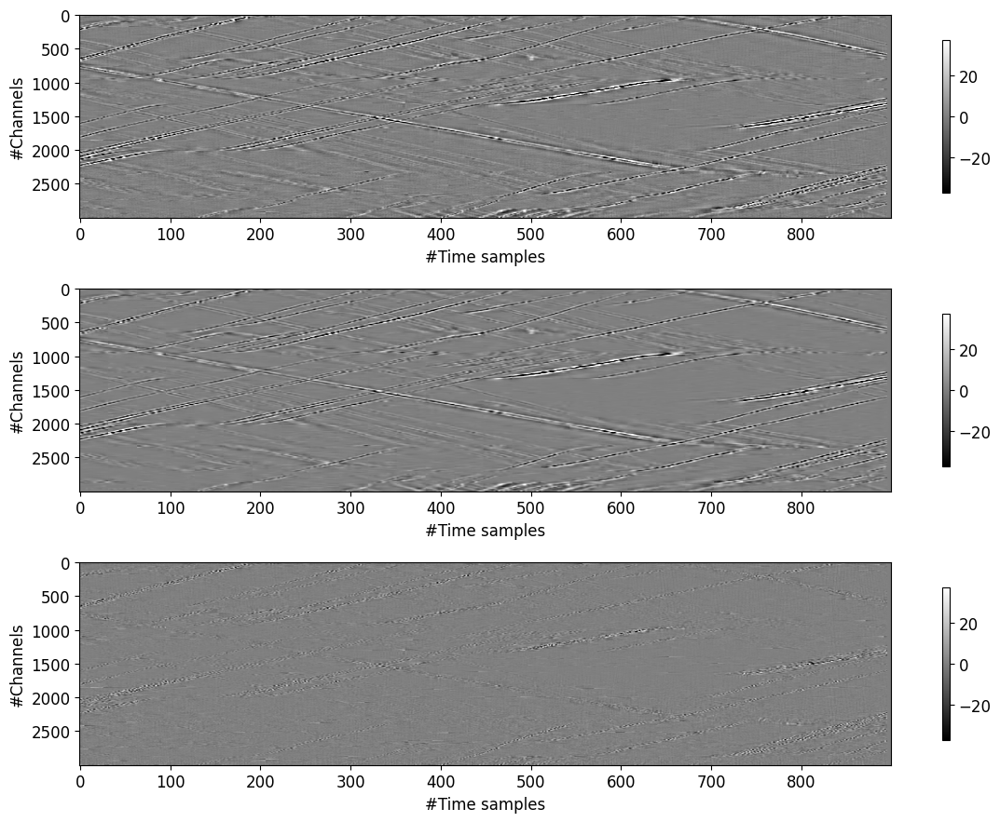

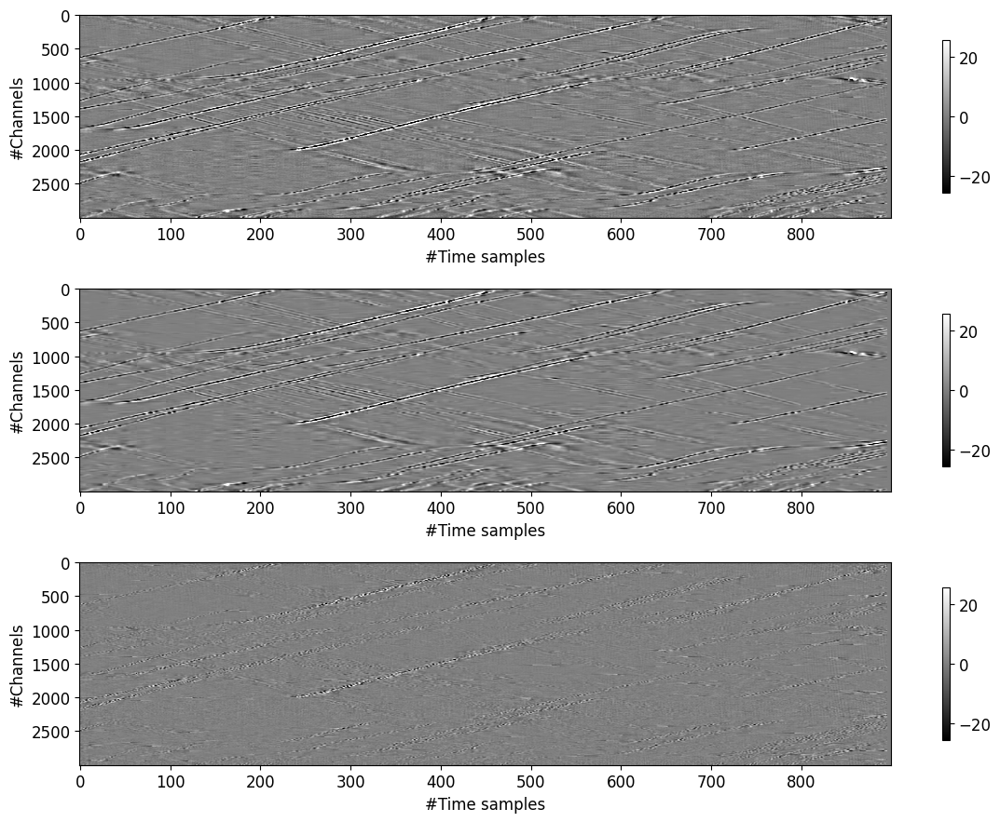

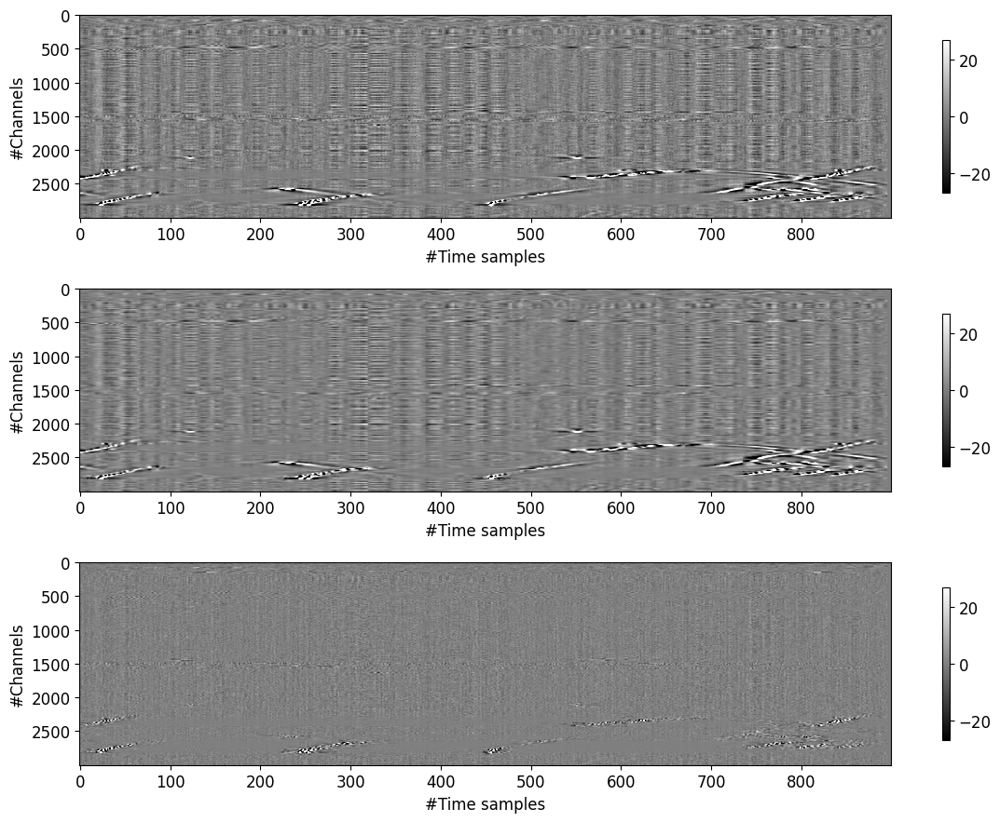

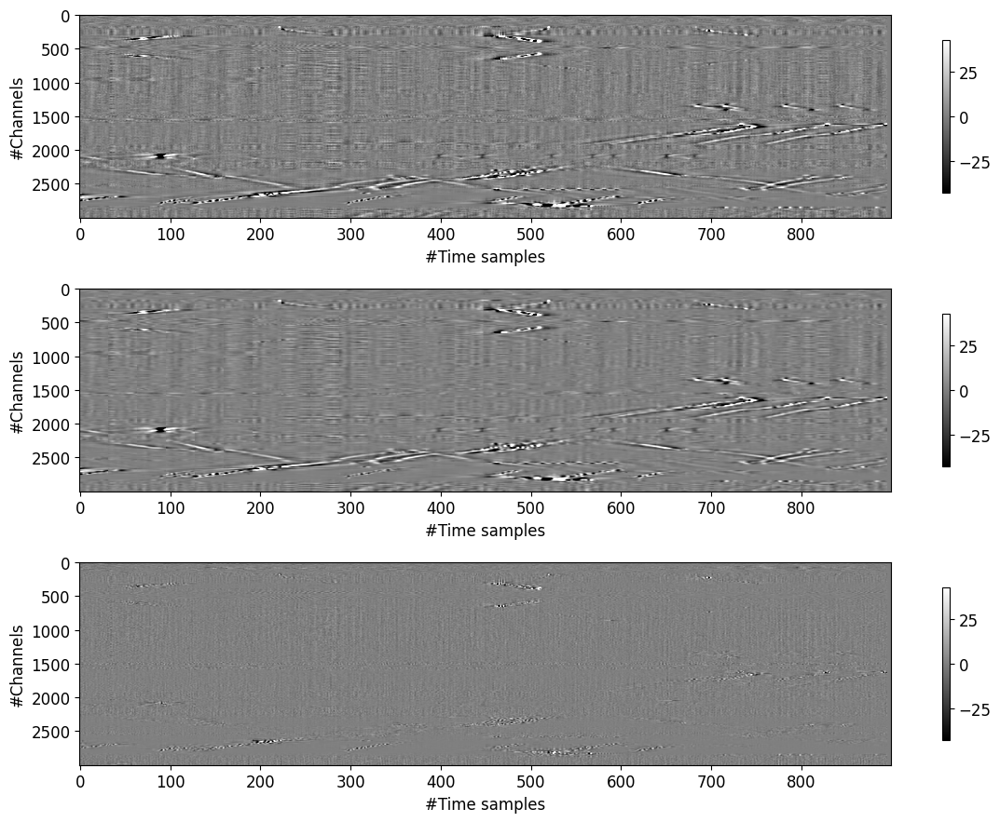

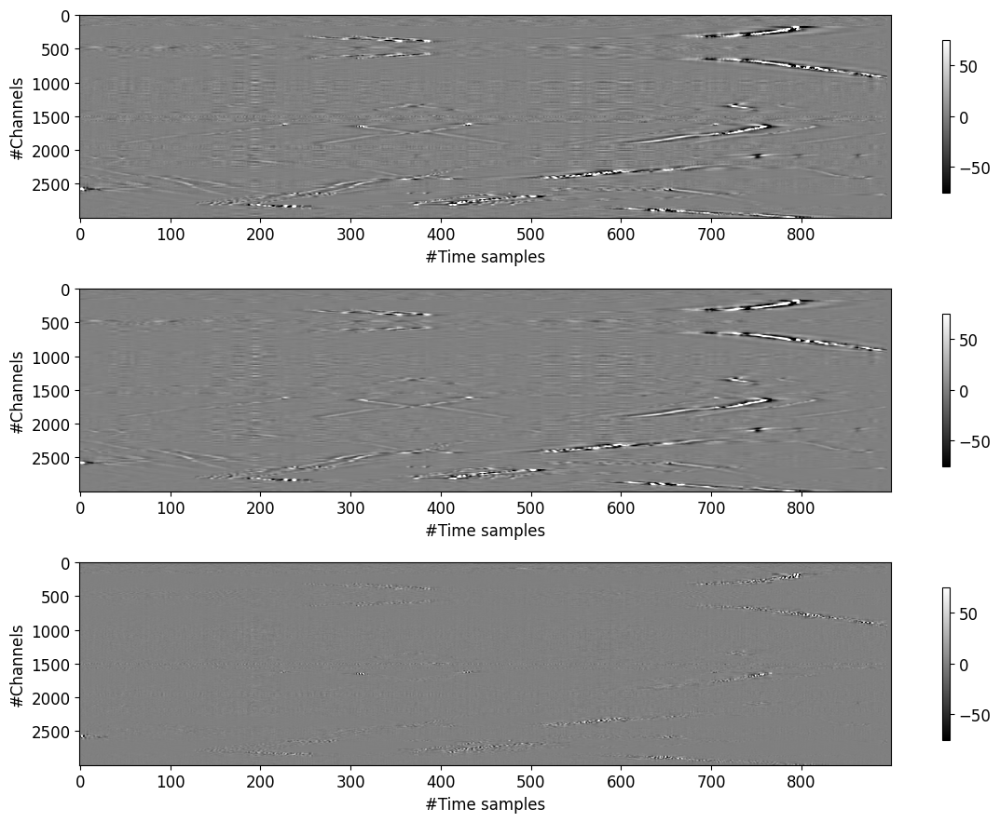

In [13]:
# parameters
patch_size=32
learning_rate = 1e-3
lmbda = 500         # [500, 1000, 2000, 4000]
latent_dims = 100    # [50, 100, 200, 400] 

for lmbda in [2000, 4000]:   
    for latent_dims in [50, 100, 200, 400]:   

        path = f"../results/model_patch{patch_size}_lmbda{lmbda}_latent{latent_dims}_learning_rate{learning_rate}_epochs{epochs}_noise{add_noise}" 

        # set the model without training
        trainer_for_test, _ = train_das_model(
                            None,                         # training dataset
                            None,                           # dev dataset
                            lmbda=lmbda,                           # weight for rate–distortion Lagrangian
                            latent_dims=latent_dims,               # layers in latent space
                            patch_size = patch_size,               # patch size of the image, must be dividable by 4
                            epochs=epochs,                         # epoch
                            batch_size=batch_size,                 # batch size
                            learning_rate=learning_rate,           # learning rate
                            validation_freq=validation_freq,       # validation frequency
                            launch_trainer = False)                # launch the trainer

        # load the pretrained model
        trainer_for_test.load_weights(os.path.join(path, 'model'))

        # Setup the trained model 
        compressor, decompressor = make_das_codec(trainer_for_test)


        for i, file in enumerate(file_test[1:-1:4]):
            print(file)

            # Load the test data
            pdata = norm_channel(np.load(file)['pdata'])
            patches_original, _, factors = extract_image_patches(pdata, patch_size)
            patches_original = tf.convert_to_tensor(patches_original, dtype=tf.float32)

            # Compress them to strings, and keep track of each of their information content in bits.
            strings, entropies = compressor(patches_original)

            # Decompress the images back from the strings.
            patches_decompre = decompressor(strings)

            # Reconstruct image from patches
            original_das = reconstruct_image_from_patches(patches_original, factors, pdata.shape, patch_size)
            decompre_das = reconstruct_image_from_patches(patches_decompre, factors, pdata.shape, patch_size)

            # plot
            plt.figure(figsize=(12, 9))
            plt.rcParams.update({'font.size': 12})

            s_nc = 0
            s_nt = 0
            nc = 3000
            nt = 900
            aspect = 'auto'
            vclip = 0.9

            plt.subplot(311)
            orig_plt = original_das[s_nc:nc, s_nt:nt] #TAC. TURKEYRACOON -> notice all my changes to the plots. something is wrong though.
            orig_max = np.abs(orig_plt).max()
            pclip = (1.-vclip)*orig_max
            plt.imshow(orig_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
            plt.xlabel('#Time samples')
            plt.ylabel('#Channels')
            plt.colorbar(shrink=0.75)

            plt.subplot(312)
            decom_plt = decompre_das[s_nc:nc, s_nt:nt] #TAC
            plt.imshow(decom_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
            plt.xlabel('#Time samples')
            plt.ylabel('#Channels')
            plt.colorbar(shrink=0.75)

            plt.subplot(313)
            diff_plt = orig_plt - decom_plt #TAC
            plt.imshow(diff_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
            plt.xlabel('#Time samples')
            plt.ylabel('#Channels')
            plt.colorbar(shrink=0.75)

            plt.tight_layout()
            plt.savefig(f'../results/model_patch{patch_size}_noise{add_noise}_lmbda{lmbda}_latent_dims{latent_dims}_test{i}.png', dpi=300, pad_inches=0.1)

## Test the reconstruction for whole DAS section

../data/test/test_smcity_rwc_nc4800_ch37500-42300_nt900_sf5_bp0.08-2.0_D2022-10-02_T14-10-55_p03min.npz


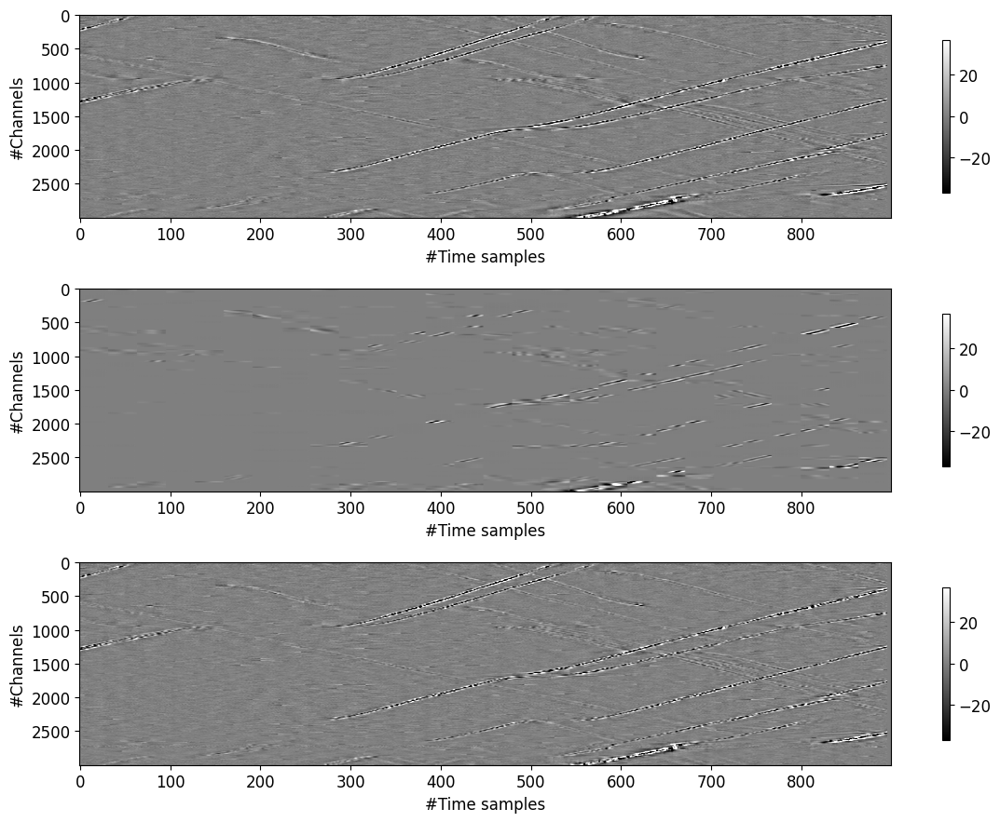

In [15]:
for i, file in enumerate(file_test[1:2]):
    print(file)
    
    # Load the test data
    pdata = norm_channel(np.load(file)['pdata'])
    patches_original, _, factors = extract_image_patches(pdata, patch_size)
    patches_original = tf.convert_to_tensor(patches_original, dtype=tf.float32)

    # Compress them to strings, and keep track of each of their information content in bits.
    strings, entropies = compressor(patches_original)

    # Decompress the images back from the strings.
    patches_decompre = decompressor(strings)

    # Reconstruct image from patches
    original_das = reconstruct_image_from_patches(patches_original, factors, pdata.shape, patch_size)
    decompre_das = reconstruct_image_from_patches(patches_decompre, factors, pdata.shape, patch_size)

    # plot
    plt.figure(figsize=(12, 9))
    plt.rcParams.update({'font.size': 12})

    s_nc = 0
    s_nt = 0
    nc = 3000
    nt = 900
    aspect = 'auto'
    vclip = 0.9

    plt.subplot(311)
    orig_plt = original_das[s_nc:nc, s_nt:nt] #TAC. TURKEYRACOON -> notice all my changes to the plots. something is wrong though.
    orig_max = np.abs(orig_plt).max()
    pclip = (1.-vclip)*orig_max
    plt.imshow(orig_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
    plt.xlabel('#Time samples')
    plt.ylabel('#Channels')
    plt.colorbar(shrink=0.75)

    plt.subplot(312)
    decom_plt = decompre_das[s_nc:nc, s_nt:nt] #TAC
    plt.imshow(decom_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
    plt.xlabel('#Time samples')
    plt.ylabel('#Channels')
    plt.colorbar(shrink=0.75)

    plt.subplot(313)
    diff_plt = orig_plt - decom_plt #TAC
    plt.imshow(diff_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
    plt.xlabel('#Time samples')
    plt.ylabel('#Channels')
    plt.colorbar(shrink=0.75)

    plt.tight_layout()
    plt.savefig(f'../results/model_patch{patch_size}_noise{add_noise}_lmbda{lmbda}_latent_dims{latent_dims}_test{i}.png', dpi=300, pad_inches=0.1)

In [ ]:
# plt.figure(figsize=(12, 9))
# plt.rcParams.update({'font.size': 12})
# from mpl_toolkits.axes_grid1 import make_axes_locatable

# s_nc = 0
# s_nt = 0
# nc = 3000
# nt = 900
# aspect = 'auto'
# vclip = 0.99

# plt.subplot(311)
# orig_plt = original_das[s_nc:nc, s_nt:nt] #TAC. TURKEYRACOON -> notice all my changes to the plots. something is wrong though.
# orig_max = np.abs(orig_plt).max()
# pclip = (1.-vclip)*orig_max
# plt.imshow(orig_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
# plt.xlabel('#Time samples')
# plt.ylabel('#Channels')
# plt.colorbar(shrink=0.75)

# plt.subplot(312)
# decom_plt = decompre_das[s_nc:nc, s_nt:nt] #TAC
# plt.imshow(decom_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
# plt.xlabel('#Time samples')
# plt.ylabel('#Channels')
# plt.colorbar(shrink=0.75)

# plt.subplot(313)
# diff_plt = orig_plt - decom_plt #TAC
# plt.imshow(diff_plt, cmap='gray', aspect=aspect, vmin=-pclip, vmax=pclip) #TAC
# plt.xlabel('#Time samples')
# plt.ylabel('#Channels')
# plt.colorbar(shrink=0.75)

# plt.tight_layout()
# #plt.savefig('../results/Final-DAS.png', dpi=300, pad_inches=0.1)

### Evaluation Matrices

In [93]:
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error

In [98]:
# MSE
mse = []
for y, y_hat in zip(patches_original, patches_decompre):
    mse.append(mean_squared_error(y.numpy(), y_hat.numpy()))
mse = np.array(mse)

(array([ 684., 1303., 1010.,  662.,  343.,  130.,   52.,   12.,    2.,
           2.]),
 array([ 103.26132976,  546.8620554 ,  990.46278104, 1434.06350668,
        1877.66423233, 2321.26495797, 2764.86568361, 3208.46640925,
        3652.06713489, 4095.66786054, 4539.26858618]),
 <BarContainer object of 10 artists>)

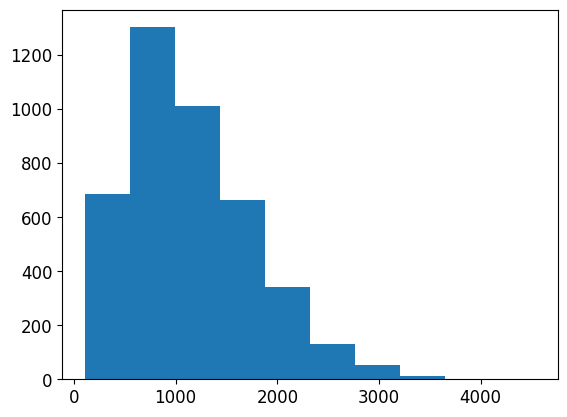

In [100]:
plt.hist(mse)

In [116]:
# Structural similarity index
SSIM = []
for y, y_hat in zip(patches_original, patches_decompre):
    y1 = y.numpy().squeeze()
    y2 = y_hat.numpy().squeeze()
    SSIM.append(ssim(y1,y2, data_range=y1.max() - y1.min()))
SSIM = np.array(SSIM)

(array([102., 441., 611., 606., 669., 665., 592., 308., 133.,  73.]),
 array([0.03964793, 0.13055792, 0.22146792, 0.31237791, 0.40328791,
        0.4941979 , 0.58510789, 0.67601789, 0.76692788, 0.85783788,
        0.94874787]),
 <BarContainer object of 10 artists>)

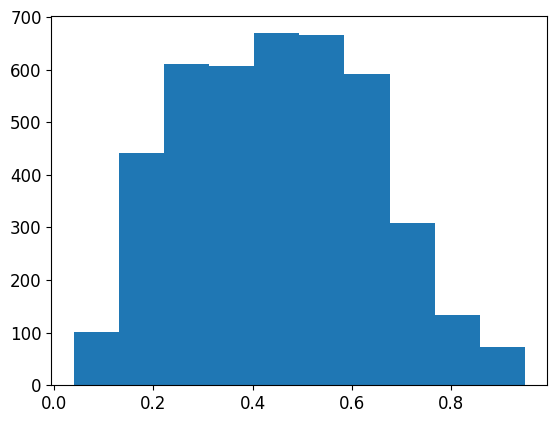

In [117]:
plt.hist(SSIM)

In [18]:
import numpy as np
import matplotlib.pyplot as plt

def fk_spectrum(signal, time_axis, x_axis, vclip = 0.7, f_lim = None, kx_lim = None):
       
    # [time axis, spatial axis]
    signal = signal.T
    Nt, Nx = signal.shape
    
    if Nt != time_axis.shape[0] or Nx != x_axis.shape[0]:
        raise ValueError("Wrong size")

    # Perform 2D Fourier Transform
    spectrum = np.fft.fftshift(np.fft.fft2(signal))

    # Generate frequency and wavenumber axes
    dt = time_axis[1] - time_axis[0]
    dx = x_axis[1] - x_axis[0]
    freq_axis = np.fft.fftshift(np.fft.fftfreq(Nt, dt))
    wavenum_axis = np.fft.fftshift(np.fft.fftfreq(Nx, dx))
    
    # Plot F-K spectrum
    plt.figure(figsize=(8, 4))
    pclip = (1.-vclip)*np.abs(spectrum).max()
    plt.imshow(np.abs(spectrum), vmin=0, vmax=pclip, aspect='auto', 
               extent=[wavenum_axis.min(), wavenum_axis.max(),freq_axis.min(), freq_axis.max()])

    plt.xlabel('Wavenumber')
    plt.ylabel('Frequency')
    plt.colorbar(label='Amplitude')
    plt.title('F-K Spectrum')
#     if kx_lim is not None:
#         plt.xlim(kx_lim)
#     if f_lim is not None:
#         plt.ylim(f_lim)
    
    plt.show()
    
    return spectrum, freq_axis, wavenum_axis


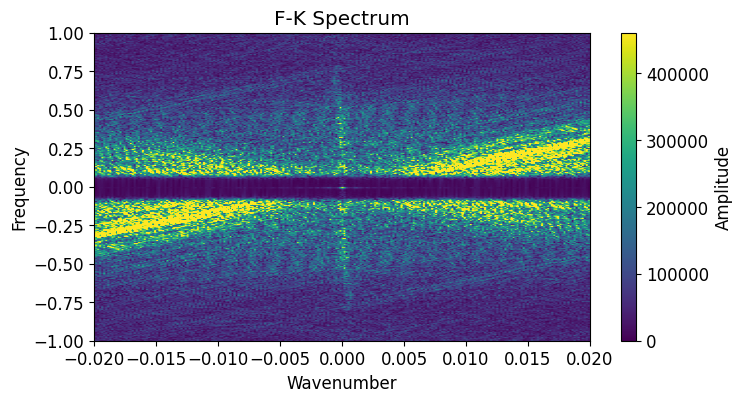

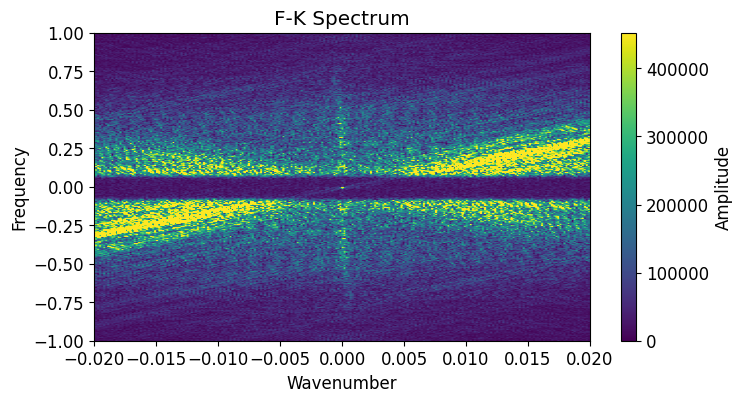

In [19]:
Nx, Nt = original_das.shape
dt = 1/5    # in seconds
dx = 1     # in meter (Not sure!!!!!)

# Generate synthetic signal
time_axis = np.linspace(0, (Nt-1) * dt, Nt)
x_axis    = np.linspace(0, (Nx-1) * dx, Nx)

# Perform F-K spectrum analysis
spectrum, freq_axis, wavenum_axis = fk_spectrum(original_das, time_axis, x_axis, vclip = 0.7, f_lim=[-1, 1], kx_lim=[-0.02, 0.02])

spectrum, freq_axis, wavenum_axis = fk_spectrum(decompre_das, time_axis, x_axis, vclip = 0.7, f_lim=[-1, 1], kx_lim=[-0.02, 0.02])